In [27]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import openpyxl

data_dir="/Users/shaunwarrington/Documents/baby_xtract_git/Data"

In [28]:
FA = pd.read_csv(f"{data_dir}/FA_0.001.txt", header=None, sep=",", names=["subID", "sesID","tract", "FA"])
MD = pd.read_csv(f"{data_dir}/MD_0.001.txt", header=None, sep=",", names=["subID", "sesID","tract", "MD"])

In [29]:
DTI_all = pd.merge(FA, MD, how="left")

In [30]:
info = pd.read_excel(f"{data_dir}/FINAL_dHCP_all_subjects_for_release.xlsx", 
                     header=2, names=["multiple_scans", "singleton", "subID","sesID","age at scan","age_at_birth",
                                     "sex","birth_weight", "head_circ", "rad_score"])
info = info[["subID", "sesID", "age at scan", "age_at_birth", "sex", "birth_weight", "head_circ", "rad_score"]]
info["sesID"] = "ses-" + info["sesID"].astype("str")


In [31]:
QC = pd.read_csv(f"{data_dir}/data_summary_QC.csv",index_col=0, header=0, names=["subID", "sesID", "scan_date", "QC","dMRI_out_of_FOV", "dMRI_pass"])
QC = QC[["subID","sesID", "QC"]]
QC["sesID"] = "ses-" + QC["sesID"]

In [32]:
info.describe()

,age at scan,age_at_birth
count,569.000000,569.000000
mean,39.940999,37.389154
std,3.062114,4.230614
min,29.285714,24.285714
25%,38.571429,35.142857
50%,40.571429,39.142857
75%,41.857143,40.428571
max,45.142857,42.285714


In [33]:
tract_vols = pd.read_csv(f"{data_dir}/tract_vols.txt",header=None, sep=",", names=["subID", "sesID", "tract", "volume"])
DTI_all = pd.merge(DTI_all, tract_vols, how="left")


In [34]:
df=pd.merge(QC, info, how="left")
df=pd.merge(df, DTI_all, how="left")
x = df.tract.str.split('_')
df['hemi'] = np.nan
df['tract'] = np.nan
for i, row in enumerate(x):
    if hasattr(row, "__len__"):
        df.loc[i,'tract'] = row[0]
        if len(row) == 2:
            df.loc[i,'hemi'] = row[1]
        else:
            df.loc[i,'hemi'] = "both"

In [35]:
tract_types = {"slf1":"association", "slf2":"association", "slf3":"association", "af":"association",
               "mdlf":"association", "ilf":"association", "ifo":"association", "uf":"association", 
               "fa":"association", "vof":"association", "mcp":"commissural", "fma":"commissural", 
               "fmi":"commissural", "ac":"commissural", "cbt":"limbic", "cbp":"limbic", "cbd":"limbic", 
               "fx":"limbic", "cst":"projection", "atr":"projection", "str":"projection", "ar":"projection",
               "or":"projection"}


df = df.dropna()
df["tract type"] = df["tract"].map(tract_types)
df = df.sort_values(by=["tract type", "tract"])

In [36]:
# plt.figure(figsize=(100, 100), dpi=200)

# df = df[df.tract == 'af']

# g = sns.lmplot(x="age at scan", y="FA", col="tract", hue="tract type", data=df,
#                scatter_kws={"alpha":0.1})

# plt.tick_params(
#     axis='x',          # changes apply to the x-axis
#     which='both',      # both major and minor ticks are affected
#     bottom=False,      # ticks along the bottom edge are off
#     top=False,         # ticks along the top edge are off
#     labelbottom=False) # labels along the bottom edge are off

# plt.tick_params(
#     axis='y',          # changes apply to the x-axis
#     which='both',      # both major and minor ticks are affected
#     left=False,      # ticks along the bottom edge are off
#     right=False,         # ticks along the top edge are off
#     labelleft=False) # labels along the bottom edge are off

# plt.xlabel('Age', fontsize=24)
# plt.ylabel('FA', fontsize=24)

In [12]:
import statsmodels.api as sm

In [13]:
df_beta = pd.DataFrame()
tract_names = df.tract.unique()[:]
for t in tract_names:
    data = df.replace("not available", np.nan)
    data = data.dropna().drop_duplicates()
    data = data[data.tract == t]
    x = data[["age at scan", "birth_weight","head_circ","QC","volume"]]
    x = (x - x.mean())/x.std()
    
    for metric in ["MD", "FA"]:
        y = (data[metric] - data[metric].mean())/data[metric].std()
        model = sm.GLM(y, sm.add_constant(x).astype(float))
        results = model.fit()
        #print(t, results.params[1], results.pvalues[1])
        df_beta = df_beta.append({
            "rate of change with age":results.params[1],
            "pval":results.pvalues[1],
            "tract":t,
            "tract type":tract_types[t],
            "metric":metric
        }, ignore_index=True)


Text(0.5, 0, 'Tract')

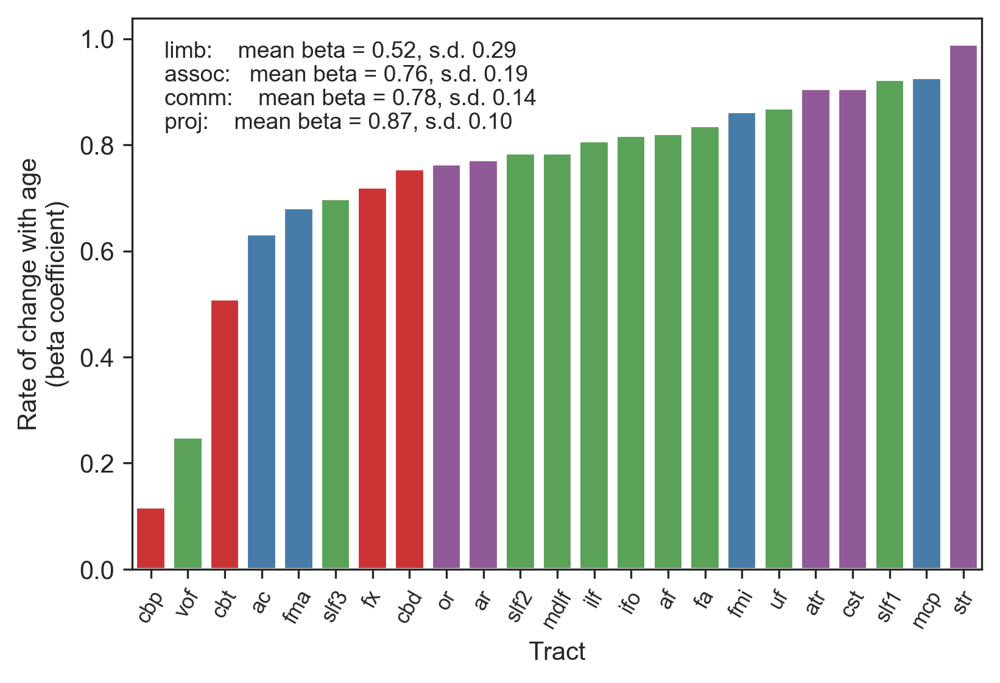

In [14]:
sns.set_style("ticks")
plt.rcParams['figure.dpi'] = 300

df_beta = df_beta.sort_values(by="rate of change with age")
g=sns.barplot(data=df_beta[df_beta.metric=="FA"], x="tract", y="rate of change with age", hue="tract type",
                dodge=False, palette="Set1",hue_order=[ "limbic", "commissural","association","projection"])
plt.xticks(rotation=60, fontsize="small")
g.legend_.remove()
# plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')

# annotate tract type mean and standard deviations
mn = df_beta[df_beta['metric'] == 'FA'].groupby('tract type').mean()
sd = df_beta[df_beta['metric'] == 'FA'].groupby('tract type').std()

mn = mn.reindex(['limbic', 'association', 'commissural', 'projection'])
sd = sd.reindex(['limbic', 'association', 'commissural', 'projection'])
mn = mn.rename(index={'limbic':'limb', 'association':'assoc', 'commissural':'comm', 'projection':'proj'})

txt = ""
for m, s in zip(mn.iterrows(), sd.iterrows()):
    item = f'{m[0]}: \t mean beta = {m[1][0]:.2f}, s.d. {s[1][0]:.2f}\n'
    txt += item
    
plt.annotate(txt.expandtabs(), xy=(0.15, 0.88), ha='left', va='top', fontsize=9, xycoords='figure fraction')
plt.ylabel('Rate of change with age\n(beta coefficient)')
plt.xlabel('Tract')


Text(0.5, 0, 'Tract')

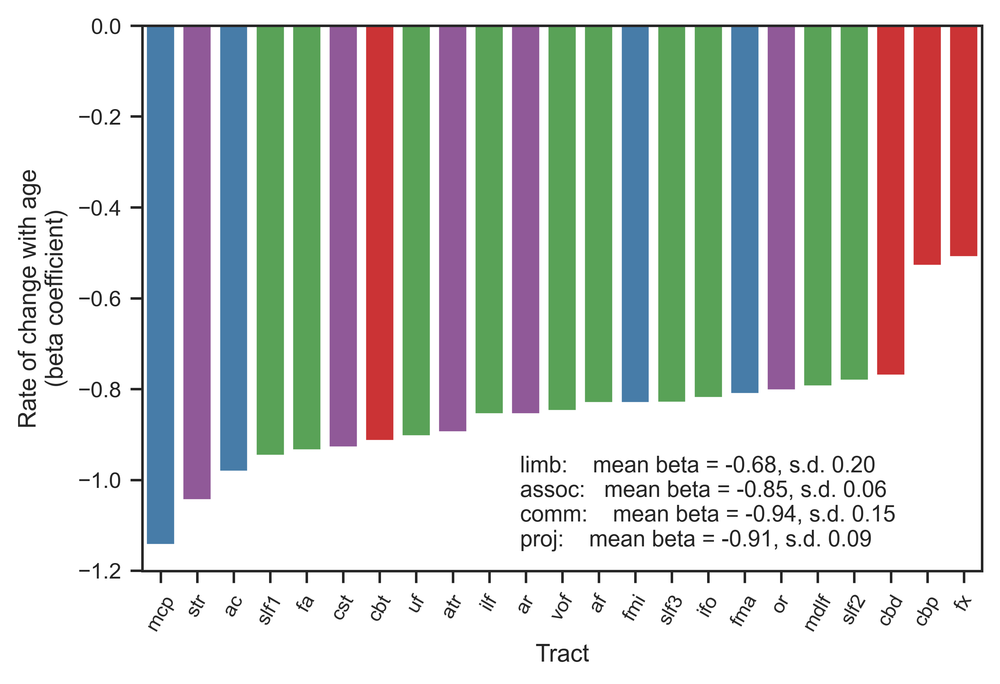

In [15]:
plt.figure(dpi=500)
sns.set_context("paper")
g = sns.barplot(data=df_beta[df_beta.metric=="MD"], x="tract", y="rate of change with age", hue="tract type", dodge=False, 
                palette="Set1",hue_order=[ "limbic", "commissural","association","projection"])
plt.xticks(rotation=60, fontsize="small")
g.legend_.remove()

# annotate tract type mean and standard deviations
mn = df_beta[df_beta['metric'] == 'MD'].groupby('tract type').mean()
sd = df_beta[df_beta['metric'] == 'MD'].groupby('tract type').std()

mn = mn.reindex(['limbic', 'association', 'commissural', 'projection'])
sd = sd.reindex(['limbic', 'association', 'commissural', 'projection'])
mn = mn.rename(index={'limbic':'limb', 'association':'assoc', 'commissural':'comm', 'projection':'proj'})

txt = ""
for m, s in zip(mn.iterrows(), sd.iterrows()):
    item = f'{m[0]}: \t mean beta = {m[1][0]:.2f}, s.d. {s[1][0]:.2f}\n'
    txt += item
    
plt.annotate(txt.expandtabs(), xy=(0.48, 0.15), ha='left', va='bottom', fontsize=9, xycoords='figure fraction')
plt.ylabel('Rate of change with age\n(beta coefficient)')
plt.xlabel('Tract')


In [16]:
df_beta.groupby(['tract type', 'metric']).describe()

rate of change with age                                \
                                     count      mean       std       min   
tract type  metric                                                         
association FA                        10.0  0.758938  0.188543  0.248842   
            MD                        10.0 -0.854750  0.056522 -0.947275   
commissural FA                         4.0  0.775096  0.141418  0.631612   
            MD                         4.0 -0.941822  0.154546 -1.143242   
limbic      FA                         4.0  0.524948  0.292913  0.116859   
            MD                         4.0 -0.681128  0.195804 -0.914725   
projection  FA                         5.0  0.867174  0.097133  0.763357   
            MD                         5.0 -0.905588  0.090742 -1.044911   

                                                            pval  \
                         25%       50%       75%       max count   
tract type  metric                                                 
association FA      0.783646  0.812677  0.832305  0.923252  10.0   
            MD     -0.891917 -0.839699 -0.822256 -0.781941  10.0   
commissural FA      0.668259  0.771074  0.877911  0.926624   4.0   
            MD     -1.022522 -0.906497 -0.825797 -0.811051   4.0   
limbic      FA      0.410726  0.614573  0.728794  0.753785   4.0   
            MD     -0.806754 -0.649827 -0.524201 -0.510132   4.0   
projection  FA      0.771937  0.905495  0.905672  0.989406   5.0   
            MD     -0.928453 -0.895214 -0.855863 -0.803497   5.0   

                                                                              \
                            mean           std            min            25%   
tract type  metric                                                             
association FA      2.094885e-06  6.624609e-06  5.546960e-134  7.248111e-104   
            MD      4.261242e-77  1.347523e-76  1.932603e-163  2.099163e-116   
commissural FA      5.573399e-19  1.098136e-18   1.827892e-50   4.307242e-28   
            MD      7.065838e-49  1.413168e-48   1.923872e-74   2.773839e-72   
limbic      FA      1.223183e-02  2.446366e-02   4.531806e-78   1.438349e-46   
            MD      4.035053e-21  8.069964e-21  5.597436e-118   4.817954e-68   
projection  FA      1.174058e-54  2.625274e-54  5.343930e-174  2.100259e-149   
            MD      1.572171e-97  3.515265e-97  9.754693e-210  5.329942e-187   

                                                                
                              50%            75%           max  
tract type  metric                                              
association FA       3.283194e-91   2.957924e-65  2.094885e-05  
            MD      7.494877e-108  1.268019e-104  4.261242e-76  
commissural FA       1.245494e-20   5.697948e-19  2.204450e-18  
            MD       3.083607e-56   7.065838e-49  2.826335e-48  
limbic      FA       2.674510e-16   1.223183e-02  4.892732e-02  
            MD       1.064499e-25   4.035159e-21  1.614000e-20  
projection  FA      2.195323e-112  8.915830e-100  5.870291e-54  
            MD      7.700866e-112  3.858601e-101  7.860468e-97

In [17]:
df_beta[df_beta.tract == "str"]

,rate of change with age,pval,tract,tract type,metric
44,-1.044911,5.329942e-187,str,projection,MD
45,0.989406,2.100259e-149,str,projection,FA


In [18]:
df_beta[df_beta.tract == "cbp"]

,rate of change with age,pval,tract,tract type,metric
30,-0.528891,1.614000e-20,cbp,limbic,MD
31,0.116859,4.892732e-02,cbp,limbic,FA


Text(0.5, 96.84000000000002, 'Age at Scan (weeks)')

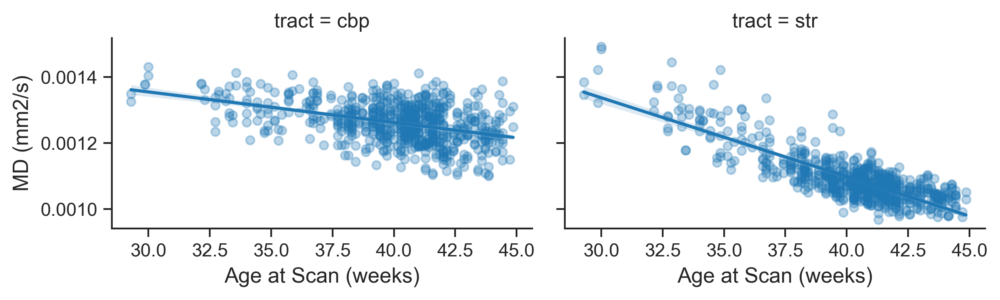

In [19]:
sns.set_context("paper", font_scale=1.2)

# plot STR for example fast tract
g = sns.lmplot(x="age at scan", y="MD", col='tract', data=df[df.tract.isin(['str', 'cbp'])], 
           scatter_kws={"alpha":0.3}, palette="cividis", height=2.5, aspect=1.6)

# g.axes[0][0].ticklabel_format(style='sci', scilimits=(0.001, 0.0014), axis='y')
g.axes[0][0].set_ylabel('MD (mm2/s)', fontsize = 12)
g.axes[0][0].set_xlabel('Age at Scan (weeks)', fontsize = 12)
g.axes[0][1].set_xlabel('Age at Scan (weeks)', fontsize = 12)

Text(0.5, 96.84000000000002, 'Age at Scan (weeks)')

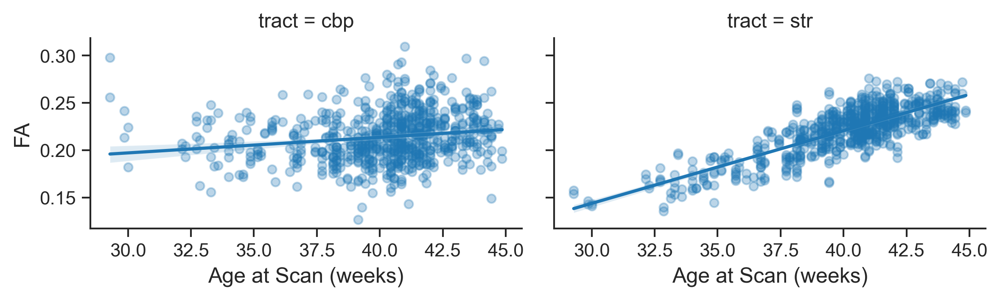

In [20]:
g = sns.lmplot(x="age at scan", y="FA", col='tract', data=df[df.tract.isin(['str', 'cbp'])], 
           scatter_kws={"alpha":0.3}, palette="cividis", height=2.5, aspect=1.6)

g.axes[0][0].set_ylabel('FA', fontsize = 12)
g.axes[0][0].set_xlabel('Age at Scan (weeks)', fontsize = 12)
g.axes[0][1].set_xlabel('Age at Scan (weeks)', fontsize = 12)

In [65]:
df_beta

,rate of change with age,pval,tract,tract type,metric
26,-1.143242,3.692040e-72,mcp,commissural,MD
44,-1.044911,5.329942e-187,str,projection,MD
20,-0.982282,1.923872e-74,ac,commissural,MD
10,-0.947275,3.320138e-130,slf1,association,MD
2,-0.934730,8.396653e-116,fa,association,MD
40,-0.928453,7.700866e-112,cst,projection,MD
32,-0.914725,5.597436e-118,cbt,limbic,MD
16,-0.903905,1.932603e-163,uf,association,MD
38,-0.895214,9.754693e-210,atr,projection,MD
6,-0.855954,2.357293e-107,ilf,association,MD


In [81]:
plt.figure(dpi=1000)

with sns.plotting_context("poster", font_scale=1.5):
    g = sns.lmplot(x="age at scan", y="FA", col="tract", data=df,
                   col_wrap=5, truncate=False,scatter_kws={"alpha":0.1}, palette="cividis")

temp = [plt.setp(ax.get_xticklabels(), rotation=30, fontsize = 25) for ax in g.axes.flat]

for ax in g.axes.flatten():
    row = df_beta[(df_beta.tract == ax.get_title().split('= ')[1]) & (df_beta.metric == 'FA')]
    beta = row['rate of change with age'].values[0]
    p = row['pval'].values[0]
    txt = f'beta = {beta:.3f}'
    if p < 0.01/df_beta.shape[0]:
        txt = f'{txt}*'
    ax.text(30, 0.3, txt, fontsize=26)

<Figure size 6000x4000 with 0 Axes>

In [82]:
with sns.plotting_context("poster", font_scale=1.5):
    g = sns.lmplot(x="age at scan", y="MD", col="tract", data=df,
                   col_wrap=5, truncate=False, scatter_kws={"alpha":0.1}, palette="inferno")


temp = [plt.setp(ax.get_xticklabels(), rotation=30, fontsize = 25) for ax in g.axes.flat]
temp = [plt.setp(ax.get_yticklabels(), fontsize = 25) for ax in g.axes.flat]

for ax in g.axes.flatten():
    row = df_beta[(df_beta.tract == ax.get_title().split('= ')[1]) & (df_beta.metric == 'MD')]
    beta = row['rate of change with age'].values[0]
    p = row['pval'].values[0]
    txt = f'beta = {beta:.3f}'
    if p < 0.01/df_beta.shape[0]:
        txt = f'{txt}*'
    ax.text(35, 0.0019, txt, fontsize=26)
